In [1]:
# NOTE FOR LOCAL EXECUTION: use pytorch kernel and execute the code below to specify cuda device
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

# BERT and Explainable AI

## Load required libraries

In [2]:
!pip install pandas
!pip install transformers
!pip install transformers-interpret

## Import libraries

In [1]:
from utils import *
import pandas as pd
import pickle
from transformers import AutoModelForSequenceClassification, AutoTokenizer
from transformers_interpret import SequenceClassificationExplainer

c:\Users\david.gallardo\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\mbti\non_masked\NS\utils.py:10: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  auc_metric = load_metric("roc_auc", trust_remote_code=True)


## Load data

In [2]:
# Original data
#df = pd.read_csv(r"C:\Users\david\OneDrive - Universitat de Barcelona (1)\Documentos\GitHub\Explainability\essays.csv", encoding = "latin-1")

# Alternatively, load fragmented validation and test partitions
df_train = pd.read_csv(r"C:\Users\david.gallardo\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_mbti_fragm_train.csv")
df_valid = pd.read_csv(r"C:\Users\david.gallardo\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_mbti_fragm_valid.csv")
df_test = pd.read_csv(r"C:\Users\david.gallardo\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_mbti_fragm_test.csv")
#df = pd.concat([df_valid, df_test], axis=0, ignore_index=True)
df = df_test

df.head()

,type,text,I/E,N/S,F/T,J/P,masked_text_bert,num_replacements,masked_text_roberta,random_masked_text_bert,random_masked_text_roberta
0,INFP,"they sleep, but yeah. How long do you think yo...",1,1,1,0,"they sleep, but yeah. How long do you think yo...",0,"they sleep, but yeah. How long do you think yo...","they sleep, but yeah. How long do you think yo...","they sleep, but yeah. How long do you think yo..."
1,INFJ,conflict earlier today in school. I stood up f...,1,1,1,1,conflict earlier today in school. I stood up f...,0,conflict earlier today in school. I stood up f...,conflict earlier today in school. I stood [UNK...,conflict earlier today in school. I stood up f...
2,INTJ,is the interesting one. Assume that everyone i...,1,1,0,1,is the interesting one. Assume that everyone i...,0,is the interesting one. Assume that everyone i...,is the interesting one. Assume that everyone i...,is the interesting one. Assume that everyone i...
3,INFJ,experience and now I'm forever traumatized.|||...,1,1,1,1,experience and now I'm forever traumatized.|||...,1,experience and now I'm forever traumatized.|||...,experience and now I'm forever traumatized.|||...,experience and now I'm forever traumatized.|||...
4,ENTP,I can respect that. I'd take an INFP any day o...,0,1,0,0,I can respect that. I'd take an [UNK] any day ...,8,I can respect that. I'd take an <unk> any day ...,I can respect that. I'd take an INFP any day o...,I can respect that. I'd take an INFP <unk> day...


In [5]:
print(len(df))

4416


## Notebook Settings

In [3]:
trait = "N/S"
text_colname="text"

## Load the fine-tuned model

In [4]:
# Path to the fine-tuned model
#model_path = r"C:\Users\david\OneDrive - Universitat de Barcelona (1)\Documentos\GitHub\Explainability\Agreeableness\results_agreeableness"  # my laptop
model_path = r"C:\Users\david.gallardo\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\fine_tuning_models\results_mbti_ns_fragm_256"

# Load the fine-tuned model and tokenizer
model_name = "bert-base-uncased"
#model_name = "FacebookAI/roberta-base"
tokenizer = AutoTokenizer.from_pretrained(model_name, do_lower_case=True)
#tokenizer = getTokenizer(model_name)
fine_tuned_model = AutoModelForSequenceClassification.from_pretrained(model_path)
cls_explainer = SequenceClassificationExplainer(fine_tuned_model, tokenizer)

  0%|          | 0/497 [00:00<?, ?it/s]

{'eval_loss': 0.2898273766040802, 'eval_accuracy': 0.8885534591194969, 'eval_roc_auc': 0.7513624007489711, 'eval_conf_matrix': array([[ 305,  237],
       [ 206, 3227]], dtype=int64), 'eval_runtime': 153.8301, 'eval_samples_per_second': 25.84, 'eval_steps_per_second': 3.231}


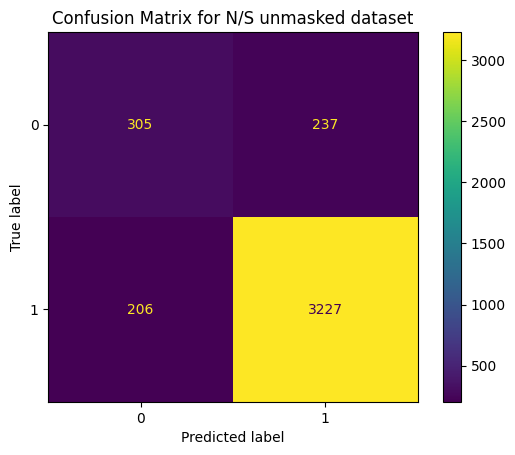

In [6]:
# Check that the model is correct

# Create datasets
X_train, X_valid, y_train, y_valid = create_partition_from_split(df_train, df_valid, text_colname, trait)
_, X_test, _, y_test = create_partition_from_split(df_train, df_test, text_colname, trait)
train_dataset, valid_dataset = create_datasets(tokenizer, X_train, X_valid, y_train, y_valid)
_, test_dataset = create_datasets(tokenizer, X_train, X_test, y_train, y_test)

# Create trainer
trainer = Trainer(
        model=fine_tuned_model,          # the instantiated Transformers model to be trained
        args=None,                       # training arguments
        train_dataset=train_dataset,     # training dataset
        eval_dataset=valid_dataset,      # evaluation dataset
        compute_metrics=compute_metrics, # the callback that computes metrics of interest
        #optimizers=(optimizer, None)
    )

results = trainer.evaluate()
conf_matrix = results['eval_conf_matrix']
print(results)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot()

# Add a title to the confusion matrix plot
plt.title("Confusion Matrix for N/S unmasked dataset")
plt.show()

In [9]:
import pickle

# Set the desired maximum sequence length
max_sequence_length = 450
attribution_threshold = 0.8  # Adjust the threshold as needed

# List to store word attributions for each row
all_word_attributions = []

# List to store sum of attributions for each row
all_sum_attributions = []

# Loop through all rows in the dataset
print("Number of rows:", len(df))
for row_index in range(len(df)):
#for row_index in range(600, 700):
    # Show progress every 100 sentences
    if row_index%100 == 0:
        print(row_index)
        
    preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                    max_sequence_length, text_colname=text_colname)
    word_attributions = cls_explainer(preproc_text)
    true_class = df.loc[row_index, trait]
    predicted_class = cls_explainer.predicted_class_name

    # Print the terms with scores greater than the threshold
    for token, score in word_attributions:
        if abs(score) > attribution_threshold:
            print(f'Token: {token}, Score: {score}')

    # Save the filtered attributions for this row along with true_class and predicted_class
    attribution_info = (word_attributions, true_class, predicted_class)
    all_word_attributions.append(attribution_info)

    # Visualize if there are filtered attributions
    if any(abs(score) > attribution_threshold for _, score in word_attributions):
        cls_explainer.visualize(true_class=true_class)
    
    # Sum of attributions for the entire text
    sum_attribution = cls_explainer.attributions.attributions_sum.sum()

    # Save the sum of attributions for this row
    all_sum_attributions.append((sum_attribution.item(), true_class, predicted_class))
    
# Save all_word_attributions to a file
word_attr_fname = get_all_word_attr_fname_mbti(trait)
with open(word_attr_fname, 'wb') as file:
    pickle.dump(all_word_attributions, file)

# Save all_sum_attributions to a file
sum_attr_fname = get_all_sum_attr_fname_mbti(trait)
with open(sum_attr_fname, 'wb') as file:
    pickle.dump(all_sum_attributions, file)

Number of rows: 4416
0
Token: int, Score: 0.842571239846544


Token: ist, Score: 0.8964737188781399


Token: as, Score: 0.8157502493745485


Token: ist, Score: -0.8611091833313942


Token: as, Score: 0.8100504501417122


Token: in, Score: 0.8902359089068278


Token: ist, Score: 0.819964398906242


Token: ist, Score: 0.8508845799555146


Token: ist, Score: 0.8148283399512807


100
Token: in, Score: 0.888318949588084


Token: ist, Score: 0.9609796021320572


Token: in, Score: 0.9253534272241378


Token: int, Score: 0.889840882993806


Token: ist, Score: 0.8566243392762674


Token: in, Score: 0.8892389005687922


Token: in, Score: 0.8283680383052513


Token: int, Score: 0.8917100897941513


200
Token: int, Score: 0.8824027860900613


Token: int, Score: 0.9320073596140336


Token: in, Score: 0.8656434167937298


Token: in, Score: 0.8210438466301788


Token: is, Score: 0.8373401516364876


Token: in, Score: 0.9567851717040903


Token indices sequence length is longer than the specified maximum sequence length for this model (548 > 512). Running this sequence through the model will result in indexing errors


Token: en, Score: 0.8645965236451869


Token: ist, Score: 0.8123360495936205


300
Token: in, Score: 0.8659080791386347


Token: in, Score: 0.830591990136796


Token: a, Score: 0.8065470540063581


Token: in, Score: 0.8284197566260123


Token: in, Score: -0.8035949793605303


Token: is, Score: 0.8338842345375104


Token: int, Score: 0.81504218515013


400
Token: is, Score: 0.87527171998172


Token: ist, Score: -0.9054694998724916


Token: ist, Score: -0.8427761243367223


Token: in, Score: 0.8556469335522758


Token: in, Score: 0.8720918064980843


500
Token: ist, Score: 0.8536818821520218


Token: ist, Score: 0.8433054717202813


Token: is, Score: 0.8041063459306619


Token: in, Score: 0.8301714223239677


Token: in, Score: 0.9048594891919548


600
Token: in, Score: 0.9022377289071364


Token: ist, Score: 0.8664392388377765


Token: ist, Score: 0.8970925566109378


Token: physics, Score: 0.8479605291190169


Token: in, Score: 0.8978550088122755


Token: in, Score: 0.8114327967748929


Token: ist, Score: 0.922112806020445


700
Token: is, Score: 0.855176968104394


Token: ist, Score: 0.8006861899083008


Token: ist, Score: 0.9282947050861844


800
Token: in, Score: 0.8454668861593299


Token: ist, Score: 0.9142407316482137


Token: ist, Score: 0.9035189014887672


Token: in, Score: 0.9589317684213541


Token: ist, Score: 0.907943214221992


900
Token: ist, Score: -0.8380534408314626


Token: in, Score: 0.930194976290175


Token: ist, Score: 0.8263181236089295


Token: ist, Score: 0.8778172324051552


Token: in, Score: 0.8211302710151435


Token: in, Score: 0.8246954034879754


1000
Token: ist, Score: 0.8834016127626274


Token: in, Score: 0.8400241134602696


Token: int, Score: 0.8525522623252623


1100
Token: ist, Score: -0.8712527731526816


Token: ist, Score: 0.863197515980164


Token: in, Score: 0.8293344480371263


Token: int, Score: 0.8764511858916182


Token: in, Score: 0.873913438866703


1200
Token: in, Score: 0.9137457002948693


Token: in, Score: 0.857919850423173


Token: in, Score: 0.8075036259498947


Token: in, Score: 0.8375483252821965


Token: ist, Score: -0.8014734331037978


1300
Token: ist, Score: -0.8574411071868662


Token: is, Score: -0.8100103535580637


Token: en, Score: 0.876780083694741


Token: ist, Score: -0.870235570204259


Token: ist, Score: -0.8155782297060776


Token: ist, Score: 0.9175663512520869


Token: ist, Score: 0.927609153483201


1400
Token: ist, Score: -0.8933307411331065


Token: ist, Score: -0.84536070797454


Token: is, Score: 0.8486168100160255


Token: int, Score: 0.9368388853738686


Token: int, Score: 0.8450407509724999


Token: in, Score: 0.8092195018626063


Token: in, Score: 0.8458760813261235


1500
Token: in, Score: 0.8943871736679468


Token: ist, Score: -0.8919981165051571


Token: in, Score: 0.8164157555791101


Token: int, Score: 0.8882715927687796


Token: ist, Score: 0.9187650329754231


Token: int, Score: 0.8435845635930107


Token: int, Score: 0.8112432279468396


1600
Token: in, Score: 0.979445553641262


Token: in, Score: 0.920593377872105


Token: ist, Score: -0.8708007487853876


Token: ist, Score: 0.8735621757746362


Token: ist, Score: 0.9370395822083053


Token: in, Score: -0.8559274438463637


1700
Token: in, Score: 0.8348259697106114


Token: int, Score: 0.829125753153634


Token: in, Score: 0.8360741035073125


Token: ist, Score: 0.8370142938553604


Token: in, Score: 0.8342969897555302


Token: ist, Score: -0.8636146430505718


Token: ist, Score: -0.8372003566477988


1800
Token: ist, Score: 0.9493746920273878


Token: /, Score: 0.8433066363841483


Token: in, Score: 0.8415572104120158


Token: int, Score: 0.8079599642712889


Token: in, Score: 0.8023852977890973


Token: in, Score: 0.8639330033817252


Token: ist, Score: 0.9243716022134641


1900
Token: in, Score: 0.8408478418422476


Token: int, Score: 0.913263771360156


Token: in, Score: 0.8393204936354685


Token: int, Score: 0.8279893903876602


Token: it, Score: -0.8116542233323588


2000
Token: ist, Score: 0.8157609297224545


Token: in, Score: 0.8897037936790009


Token: in, Score: 0.8216078523697313


Token: int, Score: 0.8550339388433136


Token: ist, Score: -0.8301324490069332


Token: in, Score: 0.9535862064727222


Token: in, Score: 0.8160506196938921


Token: ist, Score: 0.9630544982500737


Token: in, Score: 0.906000503499111


Token: hypothesis, Score: 0.8461292447528944


Token: ist, Score: 0.8658075828681117


2100
Token: int, Score: 0.9611736997142467


Token: in, Score: 0.8459387678270865


Token: ist, Score: 0.8303110719802532


Token: ist, Score: -0.8406992716171456


Token: ist, Score: -0.8567838999498997


2200
Token: in, Score: 0.8201498147032782


Token: ist, Score: -0.804497756876755


Token: in, Score: 0.8668876573856203


Token: int, Score: 0.8949782438452988


Token: in, Score: 0.8734046243683631


Token: ist, Score: -0.8211050107559966


Token: rangers, Score: 0.8155015152265848


Token: is, Score: -0.8155913304624457


Token: int, Score: 0.9518179428939996


Token: int, Score: 0.824784822380593


Token: ist, Score: 0.9183264625893327


2300
Token: ist, Score: 0.8257366498630324


Token: ist, Score: 0.8744603645791673


Token: ist, Score: 0.8160724758668901


Token: ist, Score: 0.9050715715634666


Token: in, Score: 0.8440109164647462


2400
Token: in, Score: 0.8058908133529669


Token: ist, Score: 0.8106178209656864


Token: is, Score: -0.8668654329456599


Token: in, Score: 0.885622482367996


Token: ist, Score: 0.9146879877882578


Token: int, Score: 0.8572579672326461


2500
Token: ist, Score: -0.8661343491223158


Token: int, Score: 0.8419226381443543


Token: drivers, Score: 0.836006152670681


Token: int, Score: 0.8281601748381517


Token: int, Score: 0.8481951913908916


Token: int, Score: 0.8602414304233947


Token: ist, Score: 0.8660367860434323


Token: int, Score: 0.8120804529443602


Token: in, Score: 0.9592802784605106


2600
Token: in, Score: 0.8266475923769353


Token: int, Score: 0.8378461345046068


Token: ist, Score: 0.8633365960202427


Token: in, Score: 0.934798101329487


Token: ist, Score: 0.8631969943844049


Token: in, Score: 0.8393860463447752


Token: in, Score: 0.9217416371281075


Token: ist, Score: 0.8808537904309602


Token: ist, Score: 0.950005758789324


2700
Token: int, Score: 0.8313555592273267


Token: ist, Score: -0.8338634553941825


Token: in, Score: 0.8417530769862993


Token: ist, Score: -0.8423776032206248


Token: int, Score: 0.8402130607281779


2800
Token: ist, Score: -0.8248550557867356


Token: int, Score: 0.8011308966507743


Token: ist, Score: 0.8213570875144581


Token: in, Score: 0.8524662952225616


Token: ist, Score: 0.8508167442204262


Token: in, Score: 0.8424504305355617


Token: int, Score: 0.8994056483542464


Token: in, Score: 0.8898328607031788


Token: is, Score: 0.8224212338383078


2900
Token: int, Score: 0.8652069779085891


Token: ist, Score: -0.8685284990836196


Token: int, Score: 0.9666921257576839


Token: in, Score: 0.8869950781065303


Token: int, Score: 0.9200128019676425


Token: in, Score: 0.8513652775057222


Token: in, Score: 0.8646896630093803


Token: ist, Score: 0.8026920255307857


3000
Token: int, Score: 0.89058105414025


Token: in, Score: 0.8539855530310088


Token: is, Score: 0.9588735393781608


Token: int, Score: 0.8266079081065975


Token: ist, Score: 0.8040894555387299


Token: ist, Score: 0.9030737710034457


3100
Token: ld, Score: 0.8123790306845967


Token: in, Score: 0.8729167547326144


Token: ist, Score: 0.8093511213315416


Token: in, Score: 0.8026305129584269


Token: int, Score: 0.8537393143695741


Token: in, Score: 0.8164042427513472


3200
Token: in, Score: 0.9234194063140725


Token: int, Score: 0.8819280443962431


Token: in, Score: 0.809342223181564


Token: in, Score: 0.8045153004317036


Token: in, Score: 0.8810204995293549


Token: in, Score: 0.8460878686451042


3300
Token: int, Score: 0.8161694370745862


Token: in, Score: 0.8507780848006351


Token: ist, Score: 0.9585146370771065


Token: int, Score: 0.8136363364930693


Token: en, Score: 0.8227597164285191


3400
Token: in, Score: 0.84934522539446


Token: in, Score: 0.8416563694217853


Token: in, Score: 0.8638985977414482


Token: ist, Score: 0.9289292668170138


Token: in, Score: 0.8864508163004811


Token: ist, Score: -0.8600277132338756


Token: in, Score: 0.8679431195861754


Token: ist, Score: 0.9303663393095434


3500
Token: int, Score: 0.8639652179989535


Token: ist, Score: -0.8287004734001329


Token: in, Score: 0.838165610426643


Token: int, Score: 0.8294722092085329


Token: in, Score: 0.8341706852577746


Token: in, Score: 0.8344076268605801


3600
Token: int, Score: 0.8029324953679947


Token: int, Score: 0.8928650911219753


Token: int, Score: 0.8250093916636081


Token: ist, Score: 0.9120498611602386


Token: ist, Score: 0.8975719626263973


Token: ist, Score: 0.8169176901033386


Token: in, Score: 0.8453875512239812


Token: is, Score: 0.8347623690376589


Token: ist, Score: 0.8671859923298613


Token: ist, Score: -0.8264725105051519


Token: int, Score: 0.8298707216889459


3700
Token: in, Score: 0.8956852895446893


Token: in, Score: 0.8761646375173248


Token: in, Score: 0.8439813227090811


Token: est, Score: 0.855826628568395


3800
Token: ist, Score: 0.8665600637243793


Token: in, Score: 0.8520791143060779


Token: ist, Score: 0.8853036622158308


Token: int, Score: 0.8225921147718521


Token: int, Score: 0.8084032978668425


Token: ist, Score: -0.8469521518763865


3900
Token: in, Score: 0.8057400958065323


Token: ist, Score: 0.9008914784686131


Token: ist, Score: 0.9357917688290112


Token: in, Score: 0.8320092572103056


Token: in, Score: 0.9126944438365899


4000
Token: int, Score: 0.8903644583507039


Token: in, Score: 0.8538818223553152


Token: is, Score: 0.9451295694275882


Token: ist, Score: 0.8233952880091427


Token: ist, Score: -0.8924766897485666


Token: in, Score: 0.8211481858665718


Token: int, Score: 0.854710732309806


Token: in, Score: 0.8695619579774099


Token: in, Score: 0.8019746224217532


4100
Token: int, Score: 0.8076310883548352


Token: in, Score: 0.8591553699184865


Token: ist, Score: 0.8804690432712593


4200
Token: in, Score: 0.8876983437187318


Token: in, Score: 0.8078622507787397


Token: ist, Score: 0.9522142209330284


Token: marines, Score: 0.8138786327800711


Token: ist, Score: 0.8531218893130296


Token: in, Score: 0.9310885387422032


Token: me, Score: 0.8257445798878654


4300
Token: int, Score: 0.8084941580550326


Token: int, Score: -0.8109989734328725


Token: ist, Score: -0.9217614274078603


Token: in, Score: 0.8167415735111159


4400
Token: in, Score: 0.9299223694763789


Token: ist, Score: -0.9050689968222686


In [5]:
import pickle

word_attr_fname = get_all_word_attr_fname_mbti(trait)
sum_attr_fname = get_all_sum_attr_fname_mbti(trait)

# Load the previously saved attributions from the file
with open(word_attr_fname, 'rb') as file:
    all_word_attributions = pickle.load(file)

# Load the previously saved attributions from the file
with open(sum_attr_fname, 'rb') as file:
    all_sum_attributions = pickle.load(file)

## Obtain Word Frequencies 

In [6]:
word_freq = get_word_freqs(all_word_attributions)
word_freq_label_1 = get_word_freqs(all_word_attributions, "LABEL_1")
word_freq_label_0 = get_word_freqs(all_word_attributions, "LABEL_0")

## Obtain Positive and Negative Attributions

In [7]:
# Get positive and negative attributions for the two labels
force_correct_classif=False
positive_attributions_label_1 = filter_attributions(all_word_attributions, '+', "LABEL_1", force_correct_classif)
positive_attributions_label_0 = filter_attributions(all_word_attributions, '+', "LABEL_0", force_correct_classif)
negative_attributions_label_1 = filter_attributions(all_word_attributions, '-', "LABEL_1", force_correct_classif)
negative_attributions_label_0 = filter_attributions(all_word_attributions, '-', "LABEL_0", force_correct_classif)

## Word Filtering Functions

In [8]:
#!pip install nltk

import nltk
from nltk.corpus import stopwords

# Obtain stop words
nltk.download('stopwords')
english_stopwords = stopwords.words('english')
#print(english_stopwords)

# Obtain list of words
nltk.download('words')
english_words = set(nltk.corpus.words.words())
#print(len(english_words))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\david.gallardo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\david.gallardo\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


## Word Clouds
### By attribution score

KeyboardInterrupt: 

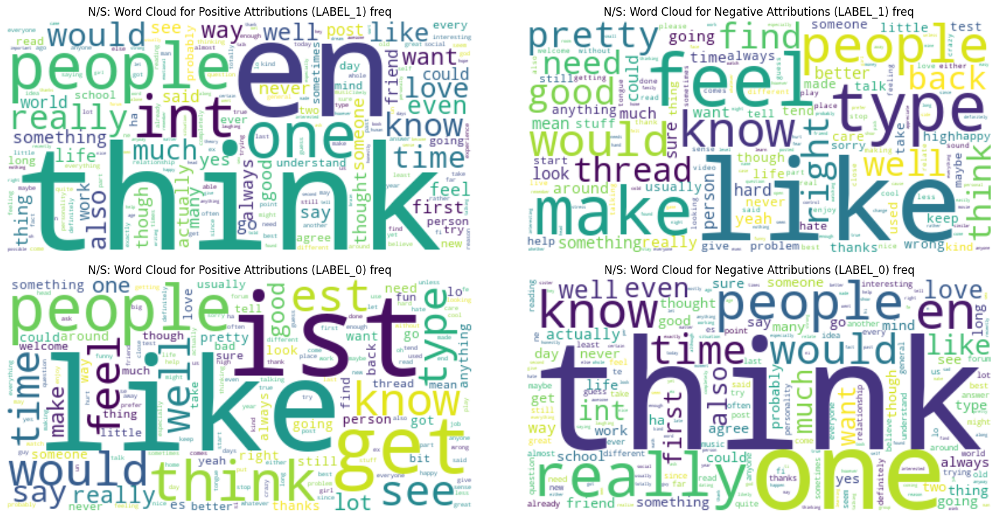

In [10]:
from wordcloud import WordCloud
from collections import Counter
import matplotlib.pyplot as plt

min_word_freq = 10
min_word_len = 2
sum_techniques = ["freq", "avg", "max", "accum", "gmean"]
#sum_techniques = ["avg"]

for sum_technique in sum_techniques:

    # Create separate lists for positive and negative attributions for LABEL_1
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, positive_attributions_label_1, min_word_freq, min_word_len, mbti_words)
    positive_words_label_1 = summarize_scores(filtered_words, sum_technique)
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, negative_attributions_label_1, min_word_freq, min_word_len, mbti_words)
    negative_words_label_1 = summarize_scores(filter_words(english_words, english_stopwords, word_freq, negative_attributions_label_1), sum_technique)

    # Create separate lists for positive and negative attributions for LABEL_0
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, positive_attributions_label_0, min_word_freq, min_word_len, mbti_words)
    positive_words_label_0 = summarize_scores(filtered_words, sum_technique)
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, negative_attributions_label_0, min_word_freq, min_word_len, mbti_words)
    negative_words_label_0 = summarize_scores(filtered_words, sum_technique)

    # Generate word clouds
    wordcloud_label_1_positive = WordCloud(background_color='white').generate_from_frequencies(positive_words_label_1)
    wordcloud_label_1_negative = WordCloud(background_color='white').generate_from_frequencies(negative_words_label_1)
    wordcloud_label_0_positive = WordCloud(background_color='white').generate_from_frequencies(positive_words_label_0)
    wordcloud_label_0_negative = WordCloud(background_color='white').generate_from_frequencies(negative_words_label_0)

    # Plot word clouds
    fig = plt.figure(figsize=(16, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(wordcloud_label_1_positive, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Positive Attributions (LABEL_1) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(wordcloud_label_1_negative, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Negative Attributions (LABEL_1) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(wordcloud_label_0_positive, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Positive Attributions (LABEL_0) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(wordcloud_label_0_negative, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Negative Attributions (LABEL_0) " + sum_technique)
    plt.axis('off')

    plt.tight_layout()

    # Save the figure as a high-resolution image
    filename = f"wordclouds_NS_{sum_technique}.png"
    plt.savefig(filename, dpi=300, bbox_inches = "tight")
    plt.close(fig)

## Barplots

In [10]:
min_word_freq = 10
min_word_len = 2
sum_technique = "avg"
# Create separate lists for positive and negative attributions for LABEL_1
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, positive_attributions_label_1, min_word_freq, min_word_len, mbti_words)
positive_words_label_1 = summarize_scores(filtered_words, sum_technique)
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, negative_attributions_label_1, min_word_freq, min_word_len, mbti_words)
negative_words_label_1 = summarize_scores(filter_words(english_words, english_stopwords, word_freq, negative_attributions_label_1), sum_technique)

# Create separate lists for positive and negative attributions for LABEL_0
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, positive_attributions_label_0, min_word_freq, min_word_len, mbti_words)
positive_words_label_0 = summarize_scores(filtered_words, sum_technique)
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, negative_attributions_label_0, min_word_freq, min_word_len, mbti_words)
negative_words_label_0 = summarize_scores(filtered_words, sum_technique)

# Plot horizontal bar plots for each category with both top and bottom significant words
plot_bar(positive_words_label_1, 'Positive Attributions (LABEL_1)', filename = "positive_label_1_barplot.png")
plot_bar(negative_words_label_1, 'Negative Attributions (LABEL_1)', filename = "negative_label_1_barplot.png")
plot_bar(positive_words_label_0, 'Positive Attributions (LABEL_0)', filename = "positive_label_0_barplot.png")
plot_bar(negative_words_label_0, 'Negative Attributions (LABEL_0)', filename = "negative_label_0_barplot.png")

Saved positive_label_1_barplot.png
Saved negative_label_1_barplot.png
Saved positive_label_0_barplot.png
Saved negative_label_0_barplot.png


## Histogram

In [ ]:
import matplotlib.pyplot as plt

# Create a histogram
filtered_sum_attributions = filter_sum_attributions(all_sum_attributions)
plt.hist(filtered_sum_attributions, bins=20, color='blue', alpha=0.7)
plt.title('Histogram of Sum of Attributions Scores')
plt.xlabel('Sum of Attributions Scores')
plt.ylabel('Frequency')
plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Create histograms
for pred_class in [None, "LABEL_1", "LABEL_0"]:
    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class)
    hist, bins, _ = plt.hist(sum_attributions, bins=20, color='blue', alpha=0.7)
    plt.title('Histogram of Sum of Attributions Scores, pred_class=' + str(pred_class))
    plt.xlabel('Sum of Attributions Scores')
    plt.ylabel('Frequency')

    # Calculate the percentiles
    percentiles = np.percentile(sum_attributions, [25, 50, 75])

    # Print the percentile values
    for percentile_value in percentiles:
        print("Percentile value:", percentile_value)

    # Draw red lines at the percentile values
    for percentile_value in percentiles:
        plt.axvline(percentile_value, color='red', linestyle='--')

    plt.show()

## Texts: highest scores

In [ ]:
import numpy as np

# Set the desired maximum sequence length
max_sequence_length = 450

# Calculate the percentiles
# percentiles = np.percentile(all_total_attributions, [25, 75])

# Set the attribution threshold as the first and third percentile values
# attribution_threshold_lower = percentiles[0]
# attribution_threshold_upper = percentiles[1]

attribution_threshold_lower = -1.2264066739414712
attribution_threshold_upper = 3.9756553009835245

# Loop through all rows in the dataset
for row_index in range(len(df)):
    # Sum of attributions for the entire text
    sum_attribution = all_sum_attributions[row_index][0]

    # Check if the total attribution falls within the specified thresholds
    if abs(sum_attribution) < attribution_threshold_lower or abs(sum_attribution) > attribution_threshold_upper:
        # Extract row information
        preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                        max_sequence_length, text_colname=text_colname)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name
        
        # Save the filtered attributions for this row
        attribution_info = (sum_attribution, true_class, predicted_class)

        # Print the information only for rows meeting the threshold
        print(f'True Class for Row {row_index}: {true_class}')
        print(f'Total Attribution for Row {row_index}: {sum_attribution}')

        # Visualize if needed
        if abs(sum_attribution) < attribution_threshold_lower or abs(sum_attribution) > attribution_threshold_upper:
            cls_explainer.visualize(true_class=true_class)

## Visualize sorted lists (explainer)

In [ ]:
# Set the desired maximum sequence length
max_sequence_length = 450

# Obtain attributions
for pred_class in ["LABEL_1", "LABEL_0"]:

    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Visualize the attributions for the texts corresponding to the highest and lowest total attribution scores
    num_elements_to_show=10
    for element in sorted_list[:num_elements_to_show]:
        # Extract row information
        row_index = element[1]
        preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                        max_sequence_length, text_colname=text_colname)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name

        # Sum of attributions for the entire text
        sum_attribution = cls_explainer.attributions.attributions_sum.sum()

        print(all_sum_attributions[row_index], sum_attribution)

        # Visualize the attributions for the text
        cls_explainer.visualize(true_class=true_class)

## Trial

In [ ]:
# Define a function to get the HTML file name
def get_html_fname(pred_class):
    return 'attributions_' + pred_class + '.html'

# Set the desired maximum sequence length
max_sequence_length = 450

# Initialize the HTML content
html_content = "<html><head><title>Posts with highest scores</title></head><body>"

# Obtain attributions
for pred_class in ["LABEL_1", "LABEL_0"]:

    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Visualize the attributions for the texts corresponding to the highest and lowest total attribution scores
    num_elements_to_show=10
    for element in sorted_list[:num_elements_to_show]:
        # Extract row information
        row_index = element[1]
        preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                        max_sequence_length, text_colname=text_colname)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name

        # Sum of attributions for the entire text
        sum_attribution = cls_explainer.attributions.attributions_sum.sum()

        # Add the information to the HTML content
        html_content += f"<p>{all_sum_attributions[row_index]}, {sum_attribution}</p>"

        # Visualize the attributions for the text
        explanation_html = cls_explainer.visualize(true_class=true_class).data

        # Add the text to the HTML content
        html_content += str(explanation_html)

    # Close the HTML content
    html_content += "</body></html>"

    # Get the HTML file name
    html_fname = get_html_fname(pred_class)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

    # Reset the HTML content for the next pred_class
    html_content = "<html><body>"

## Visualize sentences with a particular word (sum attribution ordering)

In [11]:
def get_html_fname_mbti(word_of_interest):
    return 'avg_post_' + word_of_interest.replace("/", "_") + '.html'

# Set the desired maximum sequence length
max_sequence_length = 450

# Define the list of words of interest and other parameters
words_of_interest = ["typical", "non", "sensor", "hell", "ist"]
pred_class_of_interest = "LABEL_0"
max_elements_to_show = 10

for word_of_interest in words_of_interest:
    # Get filtered sum attributions
    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class_of_interest, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Initialize HTML content string
    html_content = "<html><head><title>Word Attribution Scores</title></head><body>"

    num_elem = 0
    for element in sorted_list:
        # Extract row information
        row_index = element[1]
        
        word_attributions = all_word_attributions[row_index]
            
        # Check if word is contained in the current sentence
        score = get_max_word_score(word_of_interest, word_attributions)
        if score is not None:
            # Extract row information
            preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                        max_sequence_length, text_colname=text_colname)
            word_attributions = cls_explainer(preproc_text)
            true_class = df.loc[row_index, trait]
            predicted_class = cls_explainer.predicted_class_name
            
            # Print score
            print(word_of_interest, "score:", score)

            # Visualize and collect HTML content
            explanation_html = cls_explainer.visualize(true_class=true_class).data
            html_content += f"<h3>{word_of_interest} score: {score}</h3>"
            html_content += str(explanation_html)  # Ensure conversion to string
            
            num_elem += 1
            if num_elem == max_elements_to_show:
                break

    # Close the HTML content
    html_content += "</body></html>"

    # Close the HTML file name
    html_fname = get_html_fname_mbti(word_of_interest)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

typical score: 0.5374463232104446


typical score: 0.19645698724633856


typical score: 0.21874663987631543


typical score: 0.1513393029477777


typical score: -0.2129214862944822


typical score: 0.132795358528874


typical score: -0.007530973008324424


typical score: 0.3038933875235884


typical score: 0.09708898532898627


typical score: -0.004363116279476894


non score: -0.029672895545885276


non score: -0.010459338520028418


non score: 0.016379446654576395


non score: 0.3188544730512089


non score: 0.015121565919537228


non score: 0.025812152507887858


non score: -0.012699218091472347


non score: 0.01163307921846685


non score: -6.983475182017115e-05


non score: -0.005784669366387994


sensor score: 0.264948515679464


sensor score: 0.04674868285041358


sensor score: 0.09621905200748293


sensor score: 0.03829490810432651


sensor score: 0.1277991494848893


sensor score: 0.058586208539628024


sensor score: 0.037240722662542594


sensor score: 0.027298048681822343


sensor score: 0.03377888923215867


sensor score: 0.0022880910116759284


hell score: 0.006585612372521001


hell score: -0.002045795044874448


hell score: -0.01654281124099837


hell score: 0.004441899398107483


hell score: -0.04097938634753652


hell score: 0.011610510493984564


hell score: 0.010181942002389126


hell score: 0.2640115231836158


hell score: 0.017606893063400783


hell score: 0.03366971370228333


ist score: 0.41884155606633344


ist score: 0.44065523014096974


ist score: 0.546650246619604


ist score: 0.48579307579982645


ist score: 0.35685612644506143


ist score: 0.6618993895378348


ist score: 0.312298947951033


ist score: 0.5188280572922743


ist score: 0.46989451220172157


ist score: 0.3631348308705547


## Visualize sentences with a particular word (word attribution ordering)

In [12]:
def get_html_fname_mbti(word_of_interest):
    return 'avg_word_' + word_of_interest.replace("/", "_") + '.html'

# Set the desired maximum sequence length
max_sequence_length = 450

# Define the list of words of interest and other parameters
words_of_interest = ["typical", "non", "sensor", "hell", "ist"]
pred_class_of_interest = "LABEL_0"
max_elements_to_show = 10

for word_of_interest in words_of_interest:
    # Get word score info
    word_scores = get_max_word_scores(word_of_interest, all_word_attributions, pred_class_of_interest)

    # Sort word scores
    sorted_list = sorted(word_scores, key=lambda x: x[0], reverse=True)

    # Initialize HTML content string
    html_content = "<html><head><title>Word Attribution Scores</title></head><body>"

    for element in sorted_list[:max_elements_to_show]:
        # Extract row information
        row_index = element[1]
        
        word_attributions = all_word_attributions[row_index]
            
        # Check if word is contained in the current sentence
        score = get_max_word_score(word_of_interest, word_attributions)
        
        # Extract row information
        preproc_text = get_preproc_text(df, row_index, tokenizer, 
                                        max_sequence_length, text_colname=text_colname)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name
            
        # Print score
        print(word_of_interest, "score:", score)

        # Visualize and collect HTML content
        explanation_html = cls_explainer.visualize(true_class=true_class).data
        html_content += f"<h3>{word_of_interest} score: {score}</h3>"
        html_content += explanation_html

    # Close HTML content string
    html_content += "</body></html>"

    # Get the HTML file name
    html_fname = get_html_fname_mbti(word_of_interest)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

typical score: 0.5374463232104446


typical score: 0.3038933875235884


typical score: 0.21874663987631543


typical score: 0.19645698724633856


typical score: 0.1513393029477777


typical score: 0.132795358528874


typical score: 0.09708898532898627


typical score: -0.0035256593501009383


typical score: -0.004363116279476894


typical score: -0.007530973008324424


non score: 0.3188544730512089


non score: 0.046241449619840065


non score: 0.02821996429170303


non score: 0.025812152507887858


non score: 0.016379446654576395


non score: 0.015121565919537228


non score: 0.011945913392507982


non score: 0.01163307921846685


non score: 0.00548560027183027


non score: 0.004330149052639422


sensor score: 0.264948515679464


sensor score: 0.1277991494848893


sensor score: 0.09621905200748293


sensor score: 0.058586208539628024


sensor score: 0.04674868285041358


sensor score: 0.03829490810432651


sensor score: 0.037240722662542594


sensor score: 0.03377888923215867


sensor score: 0.027298048681822343


sensor score: 0.0022880910116759284


hell score: 0.2640115231836158


hell score: 0.06163513478071495


hell score: 0.05414715529047205


hell score: 0.04581461601797054


hell score: 0.03705826348033646


hell score: 0.03366971370228333


hell score: 0.026775006907755607


hell score: 0.017606893063400783


hell score: 0.011610510493984564


hell score: 0.010181942002389126


ist score: 0.9630544982500737


ist score: 0.9609796021320572


ist score: 0.9585146370771065


ist score: 0.9522142209330284


ist score: 0.950005758789324


ist score: 0.9493746920273878


ist score: 0.9370395822083053


ist score: 0.9357917688290112


ist score: 0.9303663393095434


ist score: 0.9289292668170138
